[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/Denis-R-V/TSR/blob/main/simple_detector_v2.ipynb)

# Система распознавания дорожных знаков на датасете RTSD

## Детектор. Инференс

In [1]:
colab = False

if colab == True:
    from google.colab import drive
    drive.mount('/content/drive')
    !pip install fiftyone
if colab == True:
    dataset_path = '.'
    checkpoints_path = '../content/drive/MyDrive/TSR/checkpoints'
else:
    dataset_path = 'data'
    checkpoints_path = 'checkpoints'

import json
import os
import numpy as np 
#import pandas as pd 
import random
import time

#import cv2
import torch
import torch.nn as nn
#import torch.utils.data
#from torch.utils.data import Dataset, DataLoader
import torchvision
import torchvision.transforms as transforms
from torchvision.transforms import functional as func
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
#from torchvision.models.detection import FasterRCNN
from torchvision.models import resnet152

from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.patches as patches
%matplotlib inline

#from pycocotools.coco import COCO
import fiftyone as fo

### Общие параметры

In [9]:
device_id = 0
if torch.cuda.is_available() == True:
    device = f'cuda:{device_id}'
#elif torch.backends.mps.is_available() == True:
#    device = 'mps'
else:
    device = 'cpu'


#detector_name = 'resnet50_augmented_b16'
#detector_name = 'resnet50_v2_augmented_b16'
#detector_name = 'resnet50_augmented_b8'
#detector_name = 'resnet50_augmented'
#detector_name = 'resnet50_b8'
detector_name = 'resnet50_v2_b8'
detector_epoch = 5       # эпоха детектора с лучшей метрикой (recall)

#classifier_name = 'resnet152'
#classifier_name = 'resnet152_sampled_full_mix'
classifier_name = 'resnet152_add_signs_alb_adam_001_sh_1_09'
classifier_epoch = 9  # эпоха классификатора с лучшей метрикой (f1)

### Загрузка моделей (детектор и классификатор) и параметров

In [3]:
def load_model_detection(detector_name, num_classes, epoch):
    # load model
    if ('resnet50_v2' in detector_name) or ('resnet50_v2' in detector_name):
        detector =torchvision.models.detection.fasterrcnn_resnet50_fpn_v2(weights=None)
        print(f"Загружен детектор {detector_name}")
    elif 'resnet50' in detector_name:
        detector = torchvision.models.detection.fasterrcnn_resnet50_fpn(weights=None)
        print(f"Загружен детектор {detector_name}")
    elif ('mobilenet' in detector_name) and ('320' in detector_name):  
        detector =torchvision.models.detection.fasterrcnn_mobilenet_v3_large_320_fpn(weights=None)
        print(f"Загружен детектор {detector_name}")
    elif ('mobilenet' in detector_name):
        detector =torchvision.models.detection.fasterrcnn_mobilenet_v3_large_fpn(weights=None)
        print(f"Загружен детектор {detector_name}")
    else:
        print("Неверно указано название детектора")
    # get number of input features for the classifier
    in_features = detector.roi_heads.box_predictor.cls_score.in_features
    # replace the pre-trained head with a new one
    detector.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
    
    # Загрузка весов модели
    checkpoint = torch.load(os.path.join(checkpoints_path, 'detector', f'chkpt_detector_{detector_name}_{epoch}.pth'), map_location=device)
    detector.load_state_dict(checkpoint['model_state_dict'])
    detector.eval
    print(f"Для детектора {detector_name} загружены веса эпохи {epoch}")
    return detector

def load_model_classifier(classifier_name, epoch, num_classes):
    # load an instance segmentation model pre-trained pre-trained on COCO
    if 'resnet152' in classifier_name:
        model = resnet152(weights=None)
        for param in model.parameters():
            param.requires_grad = False
        
        model.fc = nn.Linear(model.fc.in_features, num_classes)
        for param in model.fc.parameters():
            param.requires_grad = True
        print(f"Загружен классификатор {classifier_name}")

        # Загрузка весов модели
        checkpoint = torch.load(os.path.join(checkpoints_path, 'classifier', f'chkpt_classifier_{classifier_name}_{epoch}.pth'), map_location=device)
        model.load_state_dict(checkpoint['model_state_dict'])
        model.eval()
        print(f"Для классификатора {classifier_name} загружены веса эпохи {epoch}")
    return model

In [10]:
detector = load_model_detection(detector_name, num_classes=2, epoch=detector_epoch).to(device)
classifier = load_model_classifier(classifier_name, num_classes=156, epoch=classifier_epoch).to(device)

Загружен детектор resnet50_v2_b8
Для детектора resnet50_v2_b8 загружены веса эпохи 5
Загружен классификатор resnet152_add_signs_alb_adam_001_sh_1_09
Для классификатора resnet152_add_signs_alb_adam_001_sh_1_09 загружены веса эпохи 9


### Рассчет метрик модели на валидационной выборке

In [107]:
#Load val dataset COCO

# The directiry containing the source images
data_path = dataset_path      # можно не указывать, если в JSON путь совпадает

# The path yo the COCO labels JSON file
val_anno_file = "val_anno.json"
val_anno_path = os.path.join(dataset_path, val_anno_file)

# Import the dataset
val_dataset = fo.Dataset.from_dir(
    dataset_type=fo.types.COCODetectionDataset,
    data_path=data_path,
    labels_path=val_anno_path
)

 100% |███████████████| 5000/5000 [12.3s elapsed, 0s remaining, 523.8 samples/s]      


In [24]:
#predictions_view = val_dataset.take(50, seed=42)

In [108]:
threshold = 0.9
pred_labels = [10, 20, 30]
pred_boxes = [40, 50, 60]
pred_scores = [0.9, 0.7, 0.5]

try:
    pred_tr = [pred_scores.index(x) for x in pred_scores if x > threshold][-1]
    pred_labels = pred_labels[:pred_tr+1]
    pred_boxes = pred_boxes[:pred_tr+1]
    pred_scores = pred_scores[:pred_tr+1]    
except:
    pred_labels = []
    pred_boxes = []
    pred_scores = []

for label, score, bbox in zip (pred_labels, pred_scores, pred_boxes):
    print(label, score, bbox)

In [109]:
threshold = 0.9
# Add and evaluating Faster-RCNN detections
# Faster-RCNN detections can be calculated and added to every sample of the dataset in a new field

classes = val_dataset.default_classes
# Add predictions
detector.eval()
classifier.eval()
for i, sample in enumerate(val_dataset):
    

        
    image = Image.open(sample.filepath)
    image_tens = func.to_tensor(image).to(device)
    c,h,w = image_tens.shape

    # signs on image detection
    detect_preds = detector([image_tens])[0]
    detect_labels = detect_preds['labels'].cpu().detach().numpy()
    detect_scores = list(detect_preds['scores'].cpu().detach().numpy())
    detect_boxes = detect_preds['boxes'].cpu().detach().numpy()

    try:
        detect_tr = [detect_scores.index(x) for x in detect_scores if x > threshold][-1]
        
        detect_labels = detect_labels[:detect_tr+1]
        detect_boxes = detect_boxes[:detect_tr+1]
        detect_scores = detect_scores[:detect_tr+1]    
    except:
        detect_labels = []
        detect_boxes = []
        detect_scores = []

    detections = []
    for label, score, bbox in zip (detect_labels, detect_scores, detect_boxes):
            
        # bbox for crop
        sign_w = bbox[2] - bbox[0]
        sign_h = bbox[3] - bbox[1]
        x1 = round(max(bbox[0] - round(max((sign_w*0.1), 5)), 0))
        y1 = round(max(bbox[1] - round(max((sign_h*0.1), 5)), 0))
        x2 = round(min(bbox[2] + round(max((sign_w*0.1), 5)), w))
        y2 = round(min(bbox[3] + round(max((sign_h*0.1), 5)), h))
        bbox_for_crop = [x1, y1, x2, y2]

        # sign classification
        image_cropped1 = image.crop(bbox_for_crop)
        image_cropped = func.resize(image_cropped1, [224,224])
        image_cropped = func.to_tensor(image_cropped).to(device)
        classifier_label = int(np.argmax(classifier(image_cropped.unsqueeze(0)).data.cpu()))
        #classifier_label = classifier(image_cropped.unsqueeze(0)).data.max(1,keepdim=True)[1][0][0].cpu()
        if classifier_label != 0:
            label=classes[classifier_label]
            
            # Compute relative bounding box coordinates
            x1, y1, x2, y2 = bbox
            rel_box = [x1/w, y1/h, (x2-x1)/w, (y2-y1)/h]
            detections.append(fo.Detection(label=classes[classifier_label],
                                            bounding_box=rel_box,
                                            confidence=score
                                            )
                                )
    sample['faster_rcnn'] = fo.Detections(detections=detections)
    sample.save()
        
    if i % 10 == 0:
        print(f"\tОбработано {i} из {val_dataset.__len__()} сэмплов.")

	Обработано 0 из 5000 сэмплов.
	Обработано 10 из 5000 сэмплов.
	Обработано 20 из 5000 сэмплов.
	Обработано 30 из 5000 сэмплов.
	Обработано 40 из 5000 сэмплов.
	Обработано 50 из 5000 сэмплов.
	Обработано 60 из 5000 сэмплов.
	Обработано 70 из 5000 сэмплов.
	Обработано 80 из 5000 сэмплов.
	Обработано 90 из 5000 сэмплов.
	Обработано 100 из 5000 сэмплов.
	Обработано 110 из 5000 сэмплов.
	Обработано 120 из 5000 сэмплов.
	Обработано 130 из 5000 сэмплов.
	Обработано 140 из 5000 сэмплов.
	Обработано 150 из 5000 сэмплов.
	Обработано 160 из 5000 сэмплов.
	Обработано 170 из 5000 сэмплов.
	Обработано 180 из 5000 сэмплов.
	Обработано 190 из 5000 сэмплов.
	Обработано 200 из 5000 сэмплов.
	Обработано 210 из 5000 сэмплов.
	Обработано 220 из 5000 сэмплов.
	Обработано 230 из 5000 сэмплов.
	Обработано 240 из 5000 сэмплов.
	Обработано 250 из 5000 сэмплов.
	Обработано 260 из 5000 сэмплов.
	Обработано 270 из 5000 сэмплов.
	Обработано 280 из 5000 сэмплов.
	Обработано 290 из 5000 сэмплов.
	Обработано 300 из 50

In [ ]:
session = fo.launch_app(val_dataset)

In [68]:
# Evaluate the predictions in the `faster_rcnn` field of our `high_conf_view`
# with respect to the objects in the `ground_truth` field
def get_metrics():
    results = val_dataset.evaluate_detections(
        "faster_rcnn",
        gt_field="detections",
        eval_key="eval",
        compute_mAP=True,
    )
    model_metrics = results.metrics()
    model_metrics['mAP'] = results.mAP()
    return model_metrics


In [16]:
resnet50_v2_b8_5_resnet152_add_signs_alb_adam_001_sh_1_09_9_tr00 = get_metrics()
resnet50_v2_b8_5_resnet152_add_signs_alb_adam_001_sh_1_09_9_tr00

Evaluating detections...
 100% |███████████████| 5000/5000 [25.5s elapsed, 0s remaining, 241.9 samples/s]      
Performing IoU sweep...
 100% |███████████████| 5000/5000 [27.5s elapsed, 0s remaining, 220.2 samples/s]      


{'accuracy': 0.5967989872502034,
 'precision': 0.7505970658478335,
 'recall': 0.7444168734491315,
 'fscore': 0.7474941955943145,
 'support': 8866,
 'mAP': 0.36785707215901464}

In [81]:
resnet50_v2_b8_5_resnet152_add_signs_alb_adam_001_sh_1_09_9_tr03 = get_metrics()
resnet50_v2_b8_5_resnet152_add_signs_alb_adam_001_sh_1_09_9_tr03

Evaluating detections...
 100% |███████████████| 5000/5000 [21.7s elapsed, 0s remaining, 245.3 samples/s]      
Performing IoU sweep...
 100% |███████████████| 5000/5000 [26.8s elapsed, 0s remaining, 236.1 samples/s]      


{'accuracy': 0.589256750310085,
 'precision': 0.7927095366448467,
 'recall': 0.6965937288517934,
 'fscore': 0.7415500990574533,
 'support': 8866,
 'mAP': 0.34323896631091977}

In [69]:
resnet50_v2_b8_5_resnet152_add_signs_alb_adam_001_sh_1_09_9_tr05 = get_metrics()
resnet50_v2_b8_5_resnet152_add_signs_alb_adam_001_sh_1_09_9_tr05

Evaluating detections...
 100% |███████████████| 5000/5000 [22.2s elapsed, 0s remaining, 277.9 samples/s]      
Performing IoU sweep...
 100% |███████████████| 5000/5000 [23.7s elapsed, 0s remaining, 259.1 samples/s]      


{'accuracy': 0.5786096256684492,
 'precision': 0.8074626865671641,
 'recall': 0.6712158808933002,
 'fscore': 0.7330623306233062,
 'support': 8866,
 'mAP': 0.3255534478946481}

In [73]:
resnet50_v2_b8_5_resnet152_add_signs_alb_adam_001_sh_1_09_9_tr07 = get_metrics()
resnet50_v2_b8_5_resnet152_add_signs_alb_adam_001_sh_1_09_9_tr07

Evaluating detections...
 100% |███████████████| 5000/5000 [22.2s elapsed, 0s remaining, 268.1 samples/s]      
Performing IoU sweep...
 100% |███████████████| 5000/5000 [22.5s elapsed, 0s remaining, 256.4 samples/s]      


{'accuracy': 0.5643260374368624,
 'precision': 0.8223408861307548,
 'recall': 0.6426799007444168,
 'fscore': 0.7214941437163659,
 'support': 8866,
 'mAP': 0.3064148059572962}

In [110]:
resnet50_v2_b8_5_resnet152_add_signs_alb_adam_001_sh_1_09_9_tr09 = get_metrics()
resnet50_v2_b8_5_resnet152_add_signs_alb_adam_001_sh_1_09_9_tr09

Evaluating detections...
 100% |███████████████| 5000/5000 [20.7s elapsed, 0s remaining, 293.0 samples/s]      
Performing IoU sweep...
 100% |███████████████| 5000/5000 [19.4s elapsed, 0s remaining, 359.2 samples/s]      


{'accuracy': 0.5295731707317073,
 'precision': 0.8425222312045271,
 'recall': 0.5877509587187006,
 'fscore': 0.6924456846721149,
 'support': 8866,
 'mAP': 0.27328317193622004}

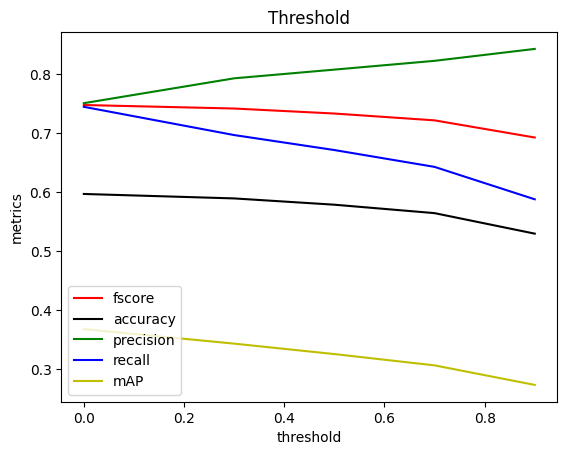

In [114]:
threshold_plot = [0, 0.3, 0.5, 0.7, 0.9]
accuracy_plot = [0.5967989872502034, 0.589256750310085, 0.5786096256684492, 0.5643260374368624, 0.5295731707317073]
precision_plot = [0.7505970658478335, 0.7927095366448467, 0.8074626865671641, 0.8223408861307548, 0.8425222312045271]
recall_plot = [0.7444168734491315, 0.6965937288517934, 0.6712158808933002, 0.6426799007444168, 0.5877509587187006]
fscore_plot = [0.7474941955943145, 0.7415500990574533, 0.7330623306233062, 0.7214941437163659, 0.6924456846721149]
mAP_plot = [0.36785707215901464, 0.34323896631091977, 0.3255534478946481, 0.3064148059572962, 0.27328317193622004]

plt.plot(threshold_plot, fscore_plot, color='r', label='fscore')
plt.plot(threshold_plot, accuracy_plot, color='k', label='accuracy')
plt.plot(threshold_plot, precision_plot, color='g', label='precision')
plt.plot(threshold_plot, recall_plot, color='b', label='recall')
plt.plot(threshold_plot, mAP_plot, color='y', label='mAP')

plt.xlabel("threshold")
plt.ylabel("metrics")
plt.title("Threshold")
plt.legend()
plt.show()

In [8]:
resnet50_v2_b8_5_resnet152_add_signs_alb_adam_001_sh_1_09_10_tr00 = get_metrics()
resnet50_v2_b8_5_resnet152_add_signs_alb_adam_001_sh_1_09_10_tr00

Evaluating detections...
 100% |███████████████| 5000/5000 [19.5s elapsed, 0s remaining, 306.1 samples/s]      
Performing IoU sweep...
 100% |███████████████| 5000/5000 [20.5s elapsed, 0s remaining, 282.4 samples/s]      


{'accuracy': 0.5898775216138329,
 'precision': 0.745334547109695,
 'recall': 0.7387773516805775,
 'fscore': 0.7420414636909483,
 'support': 8866,
 'mAP': 0.35132538723609547}

In [ ]:
%matplotlib inline
fig, ax = plt.subplots()
ax.plot(train_losses, label='Train')
ax.plot(val_losses, label='Val')
ax.set_title('detector_resnet50_all_classes')
ax.set(xlabel='Epoch', ylabel='Loss')
ax.legend()
fig.set_size_inches(5, 3)
plt.show()


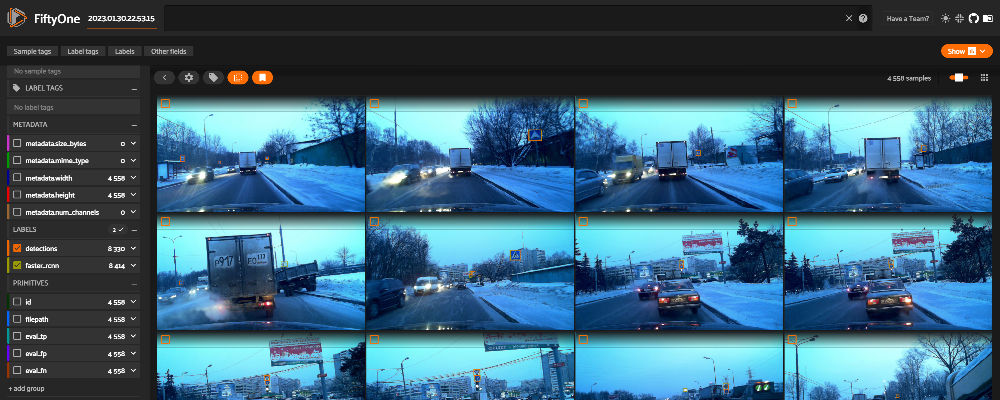

In [22]:
from fiftyone import ViewField as F

high_conf_fp_view_01 = val_dataset.filter_labels("faster_rcnn", (F("confidence") > 0.1))

session.view = high_conf_fp_view_01

In [23]:
results01 = high_conf_fp_view_01.evaluate_detections(
        "faster_rcnn",
        gt_field="detections",
        eval_key="eval",
        compute_mAP=True,
    )
model_metrics01 = results01.metrics()
model_metrics01['mAP'] = results01.mAP()
model_metrics01

Evaluating detections...
 100% |███████████████| 4558/4558 [38.4s elapsed, 0s remaining, 146.9 samples/s]      
Performing IoU sweep...
 100% |███████████████| 4558/4558 [26.2s elapsed, 0s remaining, 208.2 samples/s]      


{'accuracy': 0.6270527645515499,
 'precision': 0.7669360589493701,
 'recall': 0.7746698679471788,
 'fscore': 0.7707835642618251,
 'support': 8330,
 'mAP': 0.385514748330957}

In [24]:
def get_prediction_one_image(img_path, img_name, threshold):
    
    detector.eval()  
    transforms_img=torchvision.transforms.ToTensor()
    transforms_sign = transforms.Compose([transforms.Resize((224,224)),
                                          transforms.ToTensor(),
                                          ])
    
    # Загрузка и преобразоваие изображения в тензор
    img = Image.open(os.path.join(img_path, img_name))
    img_transformed = transforms_img(img).to(device)
    
    # Детекция знаков
    prediction = detector([img_transformed])
    pred_boxes = [[i[0], i[1], i[2], i[3]] for i in list(prediction[0]['boxes'].detach().cpu().numpy())]
    #pred_labels = list(prediction[0].get('labels').cpu().numpy())
    pred_scores = list(prediction[0].get('scores').detach().cpu().numpy())
    #pred_tr = [pred_scores.index(x) for x in pred_scores if x > threshold][-1]
    #pred_labels = pred_labels[:pred_tr+1]
    #pred_boxes = pred_boxes[:pred_tr+1]
    #pred_scores = pred_scores[:pred_tr+1]
    
    # Классификация знаков
    pred_labels = []
    for i in range(len(pred_boxes)):
        sign = img.crop(pred_boxes[i])
        sign = transforms_sign(sign).to(device)
        pred_label = int(classifier(sign.unsqueeze(0)).data.max(1,keepdim=True)[1][0][0])      # можно подумать как вытащить уверенность модели  
        pred_labels.append(pred_label)
    
    return img_transformed, pred_boxes, pred_labels, pred_scores


time_start = time.time()
img_name = 'rtsd-frames/autosave16_04_2013_13_21_16_0.jpg'
threshold = 0.1
prediction = get_prediction_one_image(dataset_path, img_name, threshold)
time_end = time.time()
prediction, time_end-time_start

(torch.return_types.max(
 values=tensor([[9.2359]], device='cuda:0'),
 indices=tensor([[1]], device='cuda:0')),
 1.7573387622833252)


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds



In [ ]:
def get_prediction(img, threshold):

    # Загрузка и преобразоваие изображения в тензор
    
    transforms_img=torchvision.transforms.ToTensor()
    img_transformed = transforms_img(img).to(device)
    
    # Детекция знаков
    global detector
    detector.eval()
    prediction = detector([img_transformed])
    pred_boxes = [[i[0], i[1], i[2], i[3]] for i in list(prediction[0]['boxes'].detach().cpu().numpy())]
    #pred_labels = list(prediction[0].get('labels').cpu().numpy())
    pred_scores = list(prediction[0].get('scores').detach().cpu().numpy())
    try:
        pred_tr = [pred_scores.index(x) for x in pred_scores if x > threshold][-1]
        #pred_labels = pred_labels[:pred_tr+1]
        pred_boxes = pred_boxes[:pred_tr+1]
        pred_scores = pred_scores[:pred_tr+1]    
    except:
        pass

    # Классификация знаков
    global classifier
    classifier.eval()
    transforms_sign = torchvision.transforms.Compose([torchvision.transforms.Resize((224,224)),
                                                      torchvision.transforms.ToTensor(),
                                                      #torchvision.transforms.Normalize([0.485, 0.456, 0.406],      # 1 496
                                                      #                                 [0.229, 0.224, 0.225])
                                                      ]) 
    with open(os.path.join(dataset_path, 'label_map.json'), 'r') as read_file:
        label_map = json.load(read_file)
    read_file.close()
    label_map = {v:k for k, v in label_map.items()}
     
    pred_labels = []
    for i in range(len(pred_boxes)):
        sign = img.crop(pred_boxes[i])
        sign = transforms_sign(sign).to(device)
        pred_label = int(classifier(sign.unsqueeze(0)).data.max(1,keepdim=True)[1][0][0])      # можно подумать как вытащить уверенность модели  
        #np.argmax(classifier(sign.unsqueeze(0)).data)      альтернатива
        pred_label = label_map.get(pred_label)
        pred_labels.append(pred_label)
    return pred_boxes, pred_labels#, pred_scores

[4]

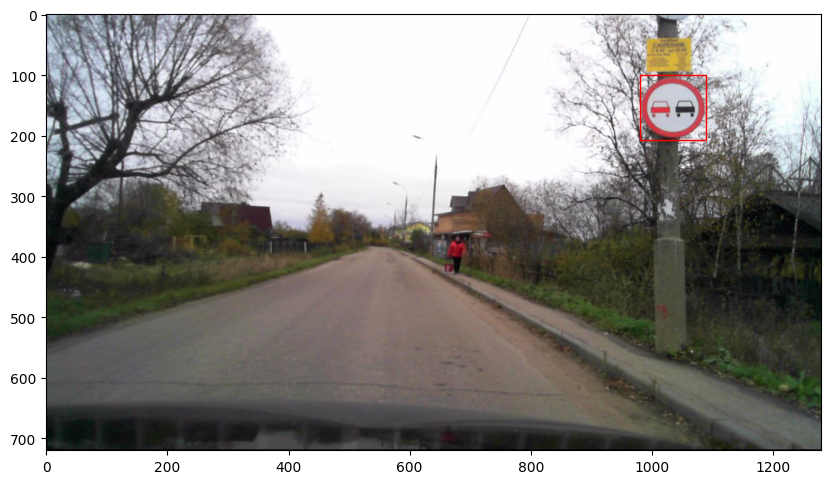

In [6]:
# Простой рисовальщик
def plot_img_bbox(img, target):
    # plot the image and bboxes
    # Bounding boxes are defined as follows: x-min y-min width height
    fig, a = plt.subplots(1,1)
    fig.set_size_inches(10,10)
    a.imshow(img)
    for box in (target):
        x, y, width, height  = box[0], box[1], box[2]-box[0], box[3]-box[1]
        rect = patches.Rectangle((x, y),
                                 width, height,
                                 linewidth = 1,
                                 edgecolor = 'r',
                                 facecolor = 'none')

        # Draw the bounding box on top of the image
        a.add_patch(rect)
    plt.show()
    
# plotting the image with bboxes. Feel free to change the index
#img, target = my_dataset[25]
img_name = 'rtsd-frames/autosave09_10_2012_13_42_22_2.jpg'
threshold = 0.1
prediction = get_prediction_one_image(dataset_path, img_name, threshold)
#img = prediction[0]
target = prediction[1]
#img = img.permute(1, 2, 0).cpu().detach().numpy()
#img = img*255
#img = img.astype(np.uint8)
img = Image.open(os.path.join(dataset_path, img_name))
display(prediction[2])
plot_img_bbox(img, target)

NameError: name 'fig' is not defined

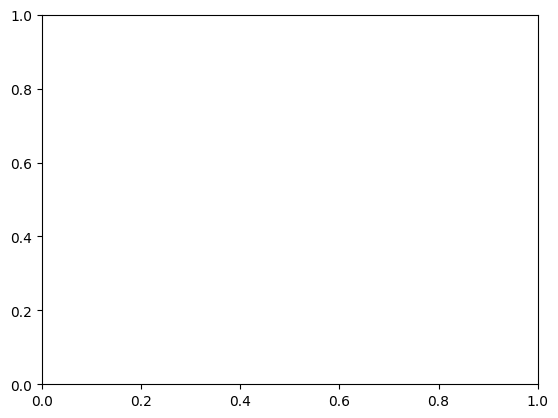

In [7]:
# Картинка
img = 'data/rtsd-frames/autosave09_10_2012_13_42_22_2.jpg'
img = Image.open(img)
ig, a = plt.subplots(1,1)
fig.set_size_inches(10,10)
a.imshow(img)

In [13]:
# рамка
transforms_img = torchvision.transforms.ToTensor()
img_transfoemed = transforms_img(img).to(device)
prediction = detector([img_transfoemed])
pred_boxes = [[i[0], i[1], i[2], i[3]] for i in list(prediction[0]['boxes'].detach().cpu().numpy())]
pred_boxes

[[981.03705, 100.093765, 1089.4335, 207.31528]]

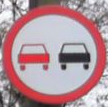

In [14]:
# Обрезка знака
img_cropped = img.crop(pred_boxes[0])
img_cropped

In [17]:
# Предсказание класса
transforms_sign = transforms.Compose([transforms.Resize((224,224)),
                                          transforms.ToTensor(),
                                          transforms.Normalize([0.485, 0.456, 0.406],      # 1 496
                                                               [0.229, 0.224, 0.225])
                                          ])
img_cropped_transformed = transforms_sign(img_cropped)
classifier(img_cropped_transformed.unsqueeze(0).to(device))

tensor([[ -0.2361,   3.0446,   0.4392,  -2.0905,  10.4370,  -2.0718,  -9.1309,
          -4.3113,  -3.8423,   5.6995,   0.4508,  -0.3814,   2.8344,   6.6780,
           8.7412,   1.5280,  -2.9908,  -0.4789,   5.9523,   0.9895,   9.3089,
          -2.0984,   2.3016,  -0.5744,  -0.3421,  -6.9954,   4.6597,  -2.1404,
           0.0326,  -3.7554,  -0.4764,  -6.3429, -11.7172,  -0.3432,  -3.4702,
          -0.2151,  -0.5790,  -1.1844,  -2.3179,   2.2840,  -4.6279,  -7.8165,
          -2.2293,  -4.8625,  -4.1499,   5.0408,  -1.0839,  -5.9420,  -3.3294,
           1.1034,   0.8756,  -2.9317,  -4.0971,  -2.9353,  -0.6493,  -5.7662,
          -0.8782,   6.6387,  -1.9533,  -0.4634,  -0.9371,  -5.5826,   0.3136,
           5.7058,  -0.8825,  -3.4302,   0.3626,   5.9991,   4.3787,   8.3273,
           4.8371,  10.0566,   7.7857,  -0.0579,  -0.0979,  -1.8875,  -0.3408,
          -2.6414,   1.5000,   5.0083,  -0.5659,  -5.8170,  -2.5786,  -1.5730,
           0.4758,   2.7131,   2.4588,  -1.4374,   0

[]

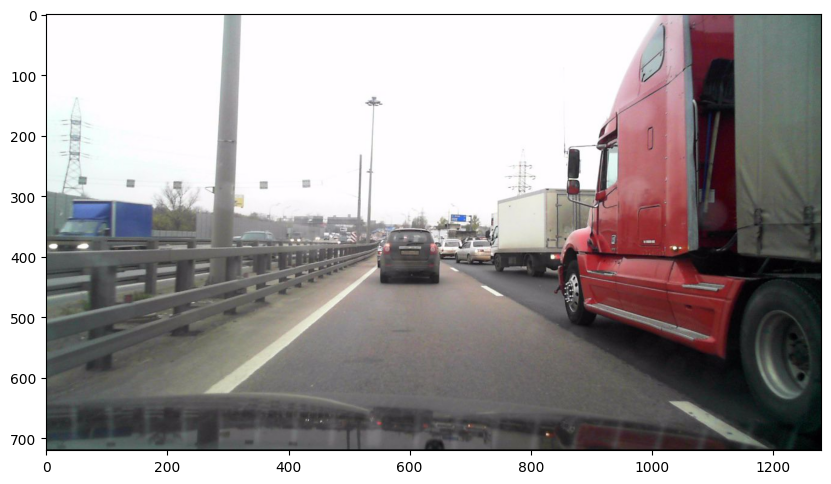

In [7]:
def plot_img_bbox(img, target):
    # plot the image and bboxes
    # Bounding boxes are defined as follows: x-min y-min width height
    fig, a = plt.subplots(1,1)
    fig.set_size_inches(10,10)
    a.imshow(img)
    for box in (target):
        x, y, width, height  = box[0], box[1], box[2]-box[0], box[3]-box[1]
        rect = patches.Rectangle((x, y),
                                 width, height,
                                 linewidth = 1,
                                 edgecolor = 'r',
                                 facecolor = 'none')

        # Draw the bounding box on top of the image
        a.add_patch(rect)
    plt.show()
    
# plotting the image with bboxes. Feel free to change the index
#img, target = my_dataset[25]
img_name = 'rtsd-frames/autosave16_10_2012_10_20_27_0.jpg'
threshold = 0.1
prediction = get_prediction_one_image(dataset_path, img_name, threshold)
img = prediction[0]
target = prediction[1]
img = img.permute(1, 2, 0).cpu().detach().numpy()
img = img*255
img = img.astype(np.uint8)
display(prediction[2])
plot_img_bbox(img, target)

In [8]:
def pycocotools_visualizer(image_id, category_id = None):
    '''функция по выводу изображения с указанным ID
    и визуализацией аннотаций с выбранными ID категорий (список)
    Если ID категорий не указаны - выводятся все аннотации для изображения'''
    if category_id:
        annotation_ids = train_anno_coco.getAnnIds(imgIds=image_id, catIds=category_id)
    else:
        annotation_ids = train_anno_coco.getAnnIds(imgIds=image_id)
            
    # загрузка аннотаций в список
    anns = train_anno_coco.loadAnns(annotation_ids)

    # путь к изображению и его название
    images_path = dataset_path
    image_name = train_anno_coco.imgs.get(image_id).get('file_name')
    image = Image.open(os.path.join(images_path, image_name))
    
    fig, ax = plt.subplots()
    fig.set_size_inches(18, 10)
    
    # Draw boxes and add label to each box
    for ann in anns:
        box = ann['bbox']
        bb = patches.Rectangle((box[0],box[1]), box[2],box[3], linewidth=1, edgecolor="yellow", facecolor="none")
        ax.add_patch(bb)
    
    ax.imshow(image)
    plt.show()

In [20]:
item = 12
classifier.eval()
pred = classifier(val_dataset.__getitem__(item)['images'].unsqueeze(0).to(device)).data.max(1,keepdim=True)[1], 
int(pred[0][0][0]), int(val_dataset.__getitem__(item)['labels'])

NameError: name 'val_dataset' is not defined

### Детекция знаков на одном изображении

(([[1142.5594, 9.751048, 1275.8434, 148.46223]], [1], [0.99598134]),
 3.2774810791015625)

In [ ]:
'''time_inference = []
for i in range(1000):
    time_start = time.time()
    img_name = 'rtsd-frames/autosave16_10_2012_08_58_25_5.jpg'
    threshold = 0.1
    prediction = get_prediction(dataset_path, img_name, threshold)
    time_end = time.time()
    times.append(time_end-time_start)
    prediction, time_end-time_start'''

In [ ]:
#min(time_inference), max(time_inference)

In [9]:
def get_predict_anno(images_path, img_name, threshold):

    if img_name == None:
        with open(os.path.join(dataset_path, 'val_anno.json'), 'r') as read_file:
            val_anno = json.load(read_file)
        read_file.close()
        img_name = val_anno.get('images')[random.randint(0, len(val_anno.get('images')))].get('file_name')

    _, pred_boxes, pred_labels, pred_scores = get_prediction_one_image(images_path, img_name, threshold)
    
    anno = {}

    images = []
    image_item = {}
    image_item['id'] = 0
    img = Image.open(os.path.join(images_path, img_name))
    transforms=torchvision.transforms.ToTensor()
    img = transforms(img).to(device)
    image_item['width'] = img.shape[2]
    image_item['height'] = img.shape[1]
    image_item['file_name'] = img_name
    images.append(image_item)
    anno['images'] = images

    annotations = []
    for i in range(len(pred_boxes)):
        anno_item = {}
        anno_item['id'] = i
        anno_item['image_id'] = 0
        anno_item['category_id'] = int(pred_labels[i])
        anno_item['area'] = (float(pred_boxes[i][2]) - float(pred_boxes[i][0]))*(float(pred_boxes[i][3]) - float(pred_boxes[i][1]))     # Исправить, так как COCO формат
        anno_item['bbox'] = [float(pred_boxes[i][0]), float(pred_boxes[i][1]), float(pred_boxes[i][2]) - float(pred_boxes[i][0]), float(pred_boxes[i][3]) - float(pred_boxes[i][1])]
        anno_item['iscrowd'] = 0
        annotations.append(anno_item)
    anno['annotations'] = annotations
    
    with open(os.path.join(dataset_path, 'train_anno_reduced.json'), 'r') as read_file:
        categories = json.load(read_file)['categories']
    read_file.close()
    categories.insert(0, {'id': 0, 'name': '0'})
    anno['categories'] = categories

    with open(os.path.join(dataset_path, 'predicted_anno.json'), 'w') as f:
        json.dump(anno, f)#ensure_ascii=False, indent=4)
    f.close()

    # загрузка изображения в fiftyone
    data_path = images_path      # можно не указывать, если в JSON путь совпадает

    # The path yo the COCO labels JSON file
    labels_file = "train_anno_bin_class.json"
    labels_path = os.path.join(dataset_path, 'predicted_anno.json')


    # Import the dataset
    dataset = fo.Dataset.from_dir(
        dataset_type=fo.types.COCODetectionDataset,
        data_path=data_path,
        labels_path=labels_path
    )
    # Визуализация набора данных
    session = fo.launch_app(dataset)

    return anno

 100% |█████████████████████| 1/1 [29.0ms elapsed, 0s remaining, 36.2 samples/s] 



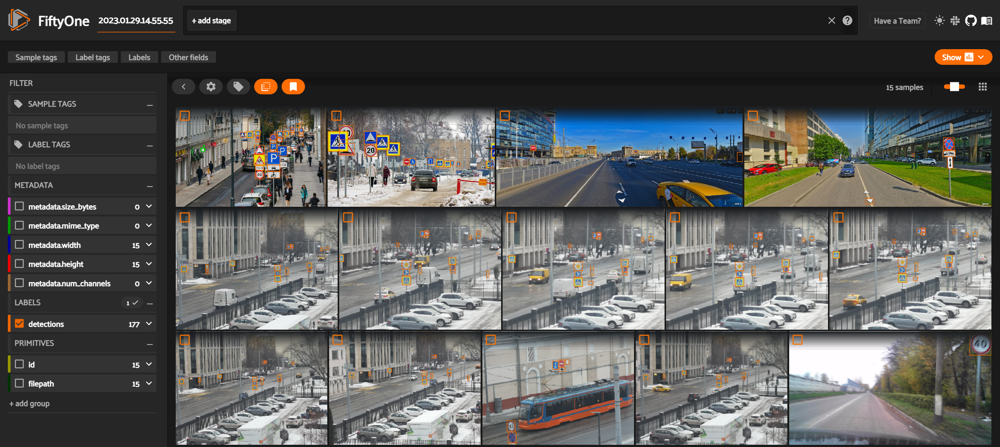


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds



In [21]:
threshold = 0.5
#img_name = None
img_name = 'image_for_predict/p20_5.jpg'
#img_name = 'rtsd-frames/autosave16_10_2012_08_58_25_5.jpg'
#img_name = 'rtsd-frames/autosave01_02_2012_09_24_03.jpg'
#prediction_anno = get_predict_anno(dataset_path, , threshold)
prediction_anno = get_predict_anno(dataset_path, img_name, threshold)

### Детекция знаков на списке изображений

In [20]:
def get_prediction_list_images(images_path, img_list, threshold):
    detector.eval()
    transforms=torchvision.transforms.ToTensor()
    images = []
    for image in img_list:
        img = Image.open(os.path.join(images_path, image)) 
        img = transforms(img).to(device)
        images.append(img)
            
    predictions = detector(images)
    
    results = []
    for prediction in predictions:
        result = []
        pred_boxes = [[i[0], i[1], i[2], i[3]] for i in list(prediction['boxes'].detach().cpu().numpy())]
        pred_labels = list(prediction.get('labels').cpu().numpy())
        pred_scores = list(prediction.get('scores').detach().cpu().numpy())

        pred_tr = [pred_scores.index(x) for x in pred_scores if x > threshold][-1]
        pred_labels = pred_labels[:pred_tr+1]
        pred_boxes = pred_boxes[:pred_tr+1]
        pred_scores = pred_scores[:pred_tr+1]
        result.append(pred_boxes)
        result.append(pred_labels)
        result.append(pred_scores)
        results.append(result)
    #boxes = []
    #for i in range(num_objs):
    #    min = coco_annotation[i]['bbox'][0]
    #    ymin = coco_annotation[i]['bbox'][1]
    #    xmax = xmin + coco_annotation[i]['bbox'][2]
    #    ymax = ymin + coco_annotation[i]['bbox'][3]
    #    boxes.append([xmin, ymin, xmax, ymax])
    
    return results#pred_boxes, pred_labels, pred_scores

time_start = time.time()
img_list = ['rtsd-frames/autosave16_10_2012_08_58_25_5.jpg',
            'rtsd-frames/autosave01_02_2012_09_24_03.jpg']
threshold = 0.1
prediction = get_prediction_list_images(dataset_path, img_list, threshold)
time_end = time.time()
prediction, time_end-time_start

([[[[75.199326, 972.1319, 222.52222, 1122.5656],
    [1542.8657, 1106.643, 1737.5795, 1314.0023],
    [1545.0399, 1470.053, 1736.6321, 1667.7103],
    [1564.9011, 1310.5304, 1708.7645, 1456.1061],
    [2606.5498, 1052.8359, 2766.9128, 1221.1691],
    [2063.5002, 437.7016, 2160.8955, 544.02673],
    [3233.14, 528.1271, 3320.5786, 616.53595],
    [1964.6079, 455.85898, 2063.8967, 568.87366],
    [1885.3796, 1546.9515, 1979.882, 1630.9113],
    [3070.323, 558.70544, 3117.9043, 654.57263],
    [1920.8273, 1229.8634, 1989.7104, 1414.8726],
    [2634.3625, 1221.4016, 2748.946, 1334.3052],
    [2053.5789, 543.81683, 2149.8413, 602.71313],
    [1423.5076, 702.3572, 1480.2064, 793.4936],
    [2778.7417, 475.0419, 2852.4285, 567.16125]],
   [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
   [0.9994147,
    0.99918574,
    0.9990421,
    0.9987042,
    0.9984707,
    0.9974382,
    0.9939465,
    0.9628407,
    0.8572064,
    0.78629065,
    0.78431153,
    0.6200919,
    0.4350687,
    0.2043883,

In [19]:
def get_predict_anno_list_images(images_path, img_list, threshold):

    if img_list == None:
        with open(os.path.join(dataset_path, 'val_anno.json'), 'r') as read_file:
            val_anno = json.load(read_file)
        read_file.close()
        img_list = [val_anno.get('images')[random.randint(0, len(val_anno.get('images')))].get('file_name')]

    predict = []
    for image in img_list:
        one_predict = get_prediction_one_image(dataset_path, image, threshold)
        predict.append(one_predict)
    anno = {}
    anno_item_id = 0

    transforms=torchvision.transforms.ToTensor()
    images = []
    annotations = []
    for i in range(len(predict)):
        img = Image.open(os.path.join(images_path, img_list[i]))
        img = transforms(img).to(device)
        
        image_item = {}
        image_item['id'] = i
        image_item['width'] = img.shape[2]
        image_item['height'] = img.shape[1]
        image_item['file_name'] = img_list[i]
        images.append(image_item)

        prediction = predict[i]
        #for j in range(len(prediction[0])):
        for j in range(len(prediction[1])):
            
            anno_item = {}
            anno_item['id'] = anno_item_id
            anno_item_id += 1
            anno_item['image_id'] = i
            #anno_item['category_id'] = int(prediction[1][j])
            anno_item['category_id'] = int(prediction[2][j])
            #anno_item['area'] = (float(prediction[0][j][2]) - float(prediction[0][j][0]))*(float(prediction[0][j][3]) - float(prediction[0][j][1]))
            anno_item['area'] = (float(prediction[1][j][2]) - float(prediction[1][j][0]))*(float(prediction[1][j][3]) - float(prediction[1][j][1]))
            #anno_item['bbox'] = [float(prediction[0][j][0]), float(prediction[0][j][1]), float(prediction[0][j][2]) - float(prediction[0][j][0]), float(prediction[0][j][3]) - float(prediction[0][j][1])]
            anno_item['bbox'] = [float(prediction[1][j][0]), float(prediction[1][j][1]), float(prediction[1][j][2]) - float(prediction[1][j][0]), float(prediction[1][j][3]) - float(prediction[1][j][1])]
            anno_item['iscrowd'] = 0
            annotations.append(anno_item)
    
    anno['images'] = images
    anno['annotations'] = annotations
    
    with open(os.path.join(dataset_path, 'train_anno_reduced.json'), 'r') as read_file:
        categories = json.load(read_file)['categories']
    read_file.close()
    categories.insert(0, {'id': 0, 'name': '0'})
    anno['categories'] = categories


    result = predict

    with open(os.path.join(dataset_path, 'predicted_anno.json'), 'w') as f:
        json.dump(anno, f)#ensure_ascii=False, indent=4)
    f.close()

    # загрузка изображения в fiftyone
    data_path = images_path      # можно не указывать, если в JSON путь совпадает

    # The path yo the COCO labels JSON file
    labels_path = os.path.join(dataset_path, 'predicted_anno.json')


    # Import the dataset
    dataset = fo.Dataset.from_dir(
        dataset_type=fo.types.COCODetectionDataset,
        data_path=data_path,
        labels_path=labels_path
    )
    # Визуализация набора данных
    session = fo.launch_app(dataset)

    return result#annotations


threshold = 0
img_list = ['image_for_predict/image1.jpg',                     # картинка из интернета
            'image_for_predict/image2.jpg',                     # картинка из интернета
            'image_for_predict/screen1.jpg',                    # скрин я яндекс карт
            'image_for_predict/screen2.jpg',                    # скрин я яндекс карт
            'image_for_predict/p20_1.jpg',                      # снимок из окна кабинета
            'image_for_predict/p20_2.jpg',                      # снимок из окна кабинета
            'image_for_predict/p20_3.jpg',                      # снимок из окна кабинета
            'image_for_predict/p20_4.jpg',                      # снимок из окна кабинета
            'image_for_predict/p20_5.jpg',                      # снимок из окна кабинета
            'image_for_predict/p20_6.jpg',                      # снимок из окна кабинета
            'image_for_predict/p20_7.jpg',                      # снимок из окна кабинета
            'image_for_predict/p20_8.jpg',                      # снимок из окна кабинета
            'image_for_predict/p20_9.jpg',                      # снимок из окна кабинета
            'rtsd-frames/autosave16_10_2012_08_58_25_5.jpg',    # тестовая выборка
            'rtsd-frames/autosave01_02_2012_09_24_03.jpg'       # тестовая выборка 
            ]

#prediction_anno = get_predict_anno_list_images(dataset_path, None, threshold)
prediction_anno = get_predict_anno_list_images(dataset_path, img_list, threshold=0.9)
prediction_anno

 100% |███████████████████| 15/15 [129.2ms elapsed, 0s remaining, 116.1 samples/s]    


[(tensor([[[0.5569, 0.5569, 0.5569,  ..., 0.4235, 0.4824, 0.5804],
           [0.5569, 0.5569, 0.5569,  ..., 0.4235, 0.4784, 0.5529],
           [0.5608, 0.5608, 0.5608,  ..., 0.4549, 0.4824, 0.4980],
           ...,
           [0.5882, 0.5922, 0.5961,  ..., 0.2627, 0.2627, 0.2667],
           [0.5922, 0.5961, 0.6000,  ..., 0.2784, 0.2941, 0.3059],
           [0.6039, 0.6078, 0.6118,  ..., 0.2863, 0.3137, 0.3333]],
  
          [[0.5804, 0.5804, 0.5804,  ..., 0.3176, 0.3765, 0.4745],
           [0.5804, 0.5804, 0.5804,  ..., 0.3176, 0.3725, 0.4471],
           [0.5843, 0.5843, 0.5843,  ..., 0.3490, 0.3765, 0.3922],
           ...,
           [0.5373, 0.5412, 0.5451,  ..., 0.2000, 0.2000, 0.2039],
           [0.5412, 0.5451, 0.5490,  ..., 0.2157, 0.2314, 0.2431],
           [0.5529, 0.5569, 0.5608,  ..., 0.2235, 0.2510, 0.2706]],
  
          [[0.5725, 0.5725, 0.5725,  ..., 0.2039, 0.2627, 0.3608],
           [0.5725, 0.5725, 0.5725,  ..., 0.2039, 0.2588, 0.3333],
           [0.5765, 0.


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds



In [ ]:
#Сравнение предсказаний на валидационной выборке и истинных значений

In [182]:
#Load val dataset COCO
# загрузка датасета
import fiftyone as fo
# The directiry containing the source images
data_path = dataset_path      # можно не указывать, если в JSON путь совпадает

# The path yo the COCO labels JSON file
val_anno_file = "val_anno_bin_class.json"
val_anno_path = os.path.join(dataset_path, val_anno_file)


# Import the dataset
val_dataset = fo.Dataset.from_dir(
    dataset_type=fo.types.COCODetectionDataset,
    data_path=data_path,
    labels_path=val_anno_path
)

In [183]:
predictions_view = val_dataset.take(50, seed=42)

In [184]:
# Add and evaluating Faster-RCNN detections
# Faster-RCNN detections can be calculated and added to every sample of the dataset in a new field
import torch, torchvision
from torchvision.transforms import functional as func
import json
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from PIL import Image

# Load the pretrained PyTorch model
def load_model_detection(num_classes):
    # load an instance segmentation model pre-trained pre-trained on COCO
    model =torchvision.models.detection.fasterrcnn_resnet50_fpn(weights=None)
    # get number of input features for the classifier
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    # replace the pre-trained head with a new one
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
    return model

num_classes = 2
model = load_model_detection(num_classes)

# Run the model on GPU if it is available
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model.to(device)

# Загрузка весов модели
checkpoint = torch.load('checkpoints/chkpt_detector_resnet50_augmented_2.pth', map_location=device)
model.load_state_dict(checkpoint['model_state_dict'])
model.eval()

classes = predictions_view.default_classes

# Add predictions
n=0
for sample in predictions_view:
    image = Image.open(sample.filepath)
    image = func.to_tensor(image).to(device)
    c,h,w = image.shape
    preds = model([image])[0]
    labels = preds['labels'].cpu().detach().numpy()
    scores = preds['scores'].cpu().detach().numpy()
    boxes = preds['boxes'].cpu().detach().numpy()
    detections = []
    for label, score, box in zip (labels, scores, boxes):
        # Compute relative bounding box coordinates
        x1, y1, x2, y2 = box
        rel_box = [x1/w, y1/h, (x2-x1)/w, (y2-y1)/h]
        detections.append(fo.Detection(label=classes[label],
                                        bounding_box=rel_box,
                                        confidence=score
                                        )
                            )
    sample['faster_rcnn'] = fo.Detections(detections=detections)
    sample.save()

In [77]:
from fiftyone import ViewField as F
#predictions_view.clone_sample_field('faster_rcnn', 'faster_rcnn_75')
#predictions_view = predictions_view.filter_labels('faster_rcnn_75', F('confidence') > 0.75)

In [71]:
#predictions_view.clone_sample_field('faster_rcnn', 'faster_rcnn_FP')
#predictions_view = predictions_view.filter_labels("faster_rcnn_FP", F("eval_coco")=="fp")


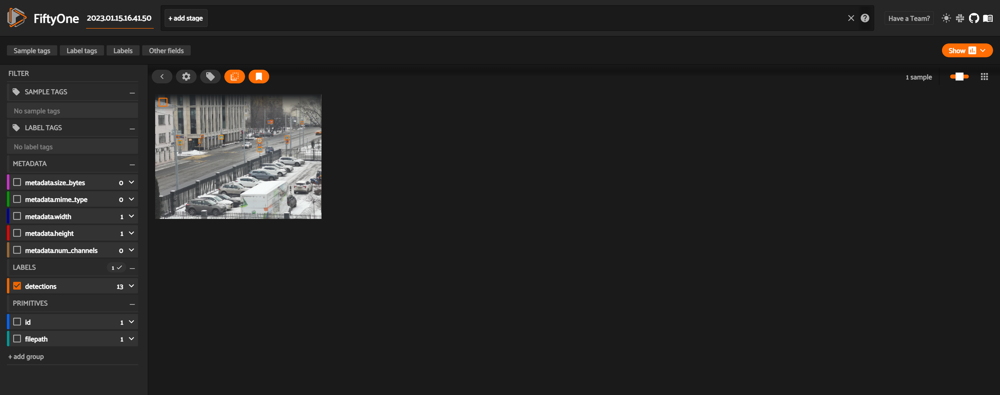

In [160]:
session = fo.launch_app(predictions_view)

In [92]:
#import fiftyone.utils.eval as foue
##Evaluating_detections = foue.evaluate_detections(predictions_view, "faster_rcnn_75", "detections")


Evaluating detections...


In [123]:
#predictions_view

Dataset:     2023.01.15.17.01.08
Media type:  image
Num samples: 48
Sample fields:
    id:             fiftyone.core.fields.ObjectIdField
    filepath:       fiftyone.core.fields.StringField
    tags:           fiftyone.core.fields.ListField(fiftyone.core.fields.StringField)
    metadata:       fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.metadata.ImageMetadata)
    detections:     fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detections)
    faster_rcnn:    fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detections)
    faster_rcnn_75: fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detections)
View stages:
    1. Take(size=50, seed=42)
    2. FilterLabels(field='faster_rcnn_75', filter={'$gt': ['$$this.confidence', 0.75]}, only_matches=True, trajectories=False)

In [130]:
#import fiftyone.utils.eval as foue

#foue.evaluate_detections(predictions_view, "faster_rcnn_75", gt_field="detections")

Evaluating detections...


In [187]:
predictions_view

Dataset:     2023.01.15.19.22.08
Media type:  image
Num samples: 50
Sample fields:
    id:          fiftyone.core.fields.ObjectIdField
    filepath:    fiftyone.core.fields.StringField
    tags:        fiftyone.core.fields.ListField(fiftyone.core.fields.StringField)
    metadata:    fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.metadata.ImageMetadata)
    detections:  fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detections)
    faster_rcnn: fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detections)
    eval_tp:     fiftyone.core.fields.IntField
    eval_fp:     fiftyone.core.fields.IntField
    eval_fn:     fiftyone.core.fields.IntField
View stages:
    1. Take(size=50, seed=42)

In [118]:
#predictions_view.first().faster_rcnn_75.Evaluating_detections

AttributeError: 'Detections' object has no attribute 'Evaluating_detections'

In [186]:
# Evaluate the predictions in the `faster_rcnn` field of our `high_conf_view`
# with respect to the objects in the `ground_truth` field
results = predictions_view.evaluate_detections(
    "faster_rcnn",
    gt_field="detections",
    eval_key="eval",
    compute_mAP=True,
)

Evaluating detections...
Performing IoU sweep...


In [163]:
results.mAP()


Could not connect session, trying again in 10 seconds



0.6746094949268527


Could not connect session, trying again in 10 seconds

Could not connect session, trying again in 10 seconds



Could not connect session, trying again in 10 seconds




Could not connect session, trying again in 10 seconds

Could not connect session, trying again in 10 seconds

Could not connect session, trying again in 10 seconds




Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds

Could not connect session, trying again in 10 seconds



Could not connect session, trying again in 10 seconds



In [188]:
from fiftyone import ViewField as F
fp_most = predictions_view.filter_labels("faster_rcnn", F("eval") == "fp",)


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 s


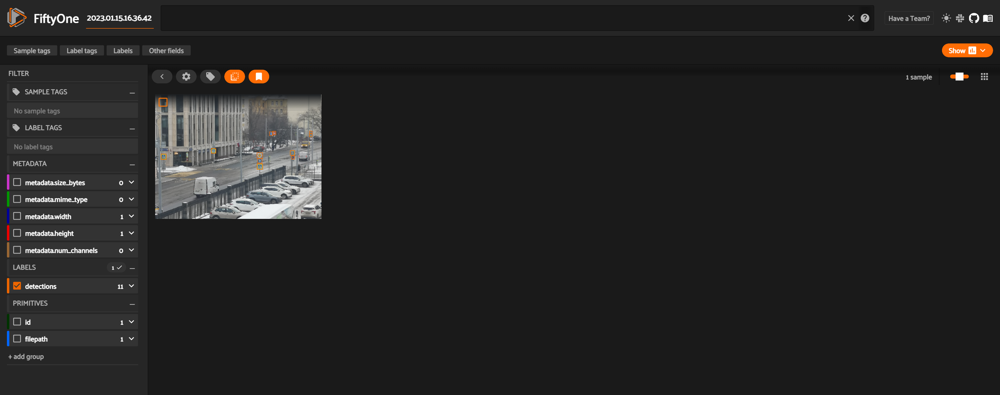

In [190]:
session.view = fp_most



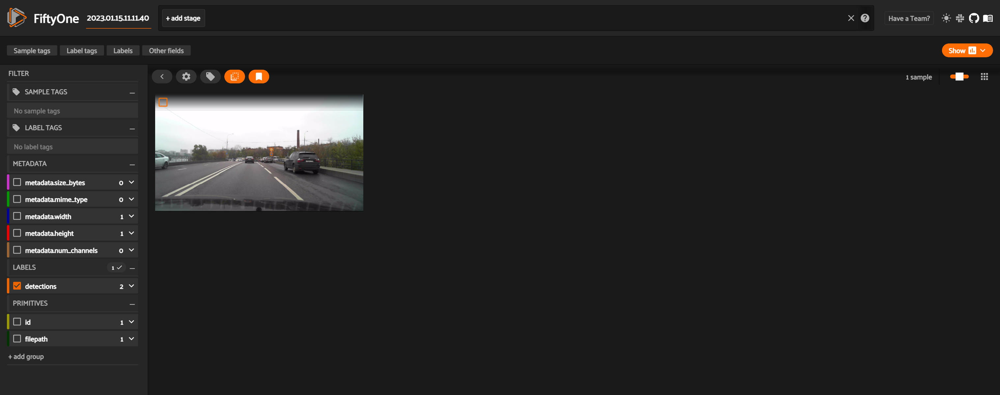


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds

Could not connect session, trying again in 10 seconds



Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 s

In [ ]:
session = fo.launch_app(fp_most)

In [194]:
fp_most.export(
    export_dir='data',
    dataset_type=fo.types.COCODetectionDataset,
    label_field='faster_rcnn',
)

Directory 'data' already exists; export will be merged with existing files


In [195]:
with open(os.path.join(dataset_path, 'labels.json'), 'r') as read_file:
    label_map = json.load(read_file)
read_file.close()
label_map

{'info': {'year': '',
  'version': '',
  'description': 'Exported from FiftyOne',
  'contributor': '',
  'url': 'https://voxel51.com/fiftyone',
  'date_created': '2023-01-15T19:30:09'},
 'licenses': [],
 'categories': [{'id': 0, 'name': 'sign', 'supercategory': None}],
 'images': [{'id': 1,
   'file_name': 'autosave10_10_2012_10_09_53_1.jpg',
   'height': 720,
   'width': 1280,
   'license': None,
   'coco_url': None},
  {'id': 2,
   'file_name': 'autosave24_10_2012_11_53_17_0.jpg',
   'height': 720,
   'width': 1280,
   'license': None,
   'coco_url': None},
  {'id': 3,
   'file_name': 'autosave09_10_2012_08_36_11_1.jpg',
   'height': 720,
   'width': 1280,
   'license': None,
   'coco_url': None},
  {'id': 4,
   'file_name': 'autosave10_10_2012_10_32_01_0.jpg',
   'height': 720,
   'width': 1280,
   'license': None,
   'coco_url': None},
  {'id': 5,
   'file_name': 'autosave23_10_2012_10_39_32_2.jpg',
   'height': 720,
   'width': 1280,
   'license': None,
   'coco_url': None},
  {'i

In [196]:
label_map.keys()

dict_keys(['info', 'licenses', 'categories', 'images', 'annotations'])

In [205]:
label_map['images']

[{'id': 1,
  'file_name': 'autosave10_10_2012_10_09_53_1.jpg',
  'height': 720,
  'width': 1280,
  'license': None,
  'coco_url': None},
 {'id': 2,
  'file_name': 'autosave24_10_2012_11_53_17_0.jpg',
  'height': 720,
  'width': 1280,
  'license': None,
  'coco_url': None},
 {'id': 3,
  'file_name': 'autosave09_10_2012_08_36_11_1.jpg',
  'height': 720,
  'width': 1280,
  'license': None,
  'coco_url': None},
 {'id': 4,
  'file_name': 'autosave10_10_2012_10_32_01_0.jpg',
  'height': 720,
  'width': 1280,
  'license': None,
  'coco_url': None},
 {'id': 5,
  'file_name': 'autosave23_10_2012_10_39_32_2.jpg',
  'height': 720,
  'width': 1280,
  'license': None,
  'coco_url': None},
 {'id': 6,
  'file_name': 'autosave23_10_2012_10_26_43_3.jpg',
  'height': 720,
  'width': 1280,
  'license': None,
  'coco_url': None},
 {'id': 7,
  'file_name': 'autosave16_04_2013_14_47_55_0.jpg',
  'height': 1080,
  'width': 1920,
  'license': None,
  'coco_url': None},
 {'id': 8,
  'file_name': 'autosave16_10

In [201]:
len(label_map['images'])
len(label_map['annotations'])

71

In [207]:
# загрузка датасета

# The directiry containing the source images
data_path = 'data/data'      # можно не указывать, если в JSON путь совпадает

# The path yo the COCO labels JSON file
labels_file = "labels.json"
labels_path = os.path.join(dataset_path, labels_file)


# Import the dataset
dataset = fo.Dataset.from_dir(
    dataset_type=fo.types.COCODetectionDataset,
    data_path=data_path,
    labels_path=labels_path
)


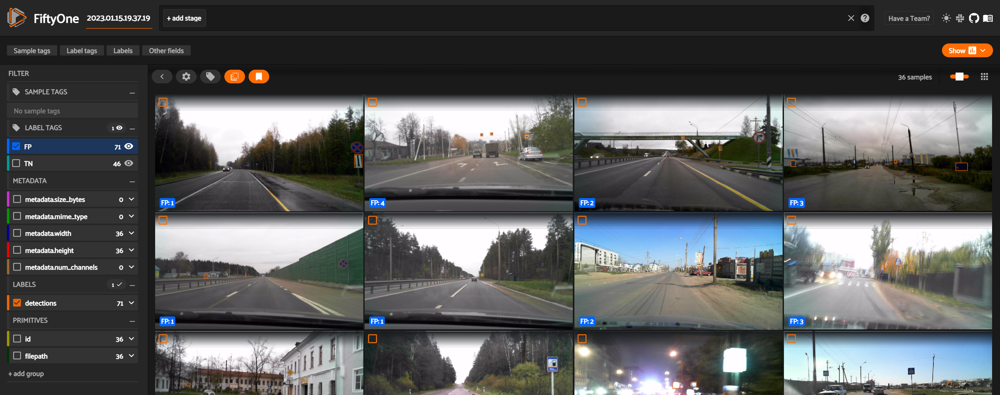

In [244]:
# Визуализация набора данных
session = fo.launch_app(dataset)

In [ ]:
dataset.mat

In [245]:
tagged_view = dataset.match_tags('FP')

In [247]:
session = fo.launch_app(tagged_view)


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds

Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds





Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds



RuntimeError: Failed to post event `state_update` to http://localhost:5151/event


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds

Could not connect session, trying again in 10 seconds



Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds




Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds

Could not connect session, trying again in 10 seconds



Could not connect session, trying again in 10 seconds

Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds



Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 s

In [235]:
selected_view = dataset.select(session.selected)

# Send the samples to CVAT for annotation
anno_key = "anno_run_1"
selected_view.annotate(
    anno_key,
    label_field="detections",
    #labels_tags = 'FP',
    launch_editor=True,
 )
 
 # Annotate in CVAT
 
 # Load annotations back into dataset
selected_view.load_annotations(anno_key)

ValueError: DatasetView is empty; there is nothing to annotate

In [ ]:
from fiftyone import ViewField as F
fp_most = dataset.tag_labels()
#.filter_labels("faster_rcnn", F("eval") == "fp",)

In [249]:
selected_view = dataset.select(session.selected)

In [252]:
selected_view2 = fo.launch_app(selected_view)

RuntimeError: Failed to post event `state_update` to http://localhost:5151/event

In [ ]:


# Send the samples to CVAT for annotation
anno_key = "anno_run_1"
selected_view.annotate(
    anno_key,
    label_field="ground_truth",
    launch_editor=True,
 )

In [217]:
dataset.tag_labels(tags='TN')

In [218]:
dataset.tag_labels

<bound method SampleCollection.tag_labels of Name:        2023.01.15.19.37.19
Media type:  image
Num samples: 36
Persistent:  False
Tags:        []
Sample fields:
    id:         fiftyone.core.fields.ObjectIdField
    filepath:   fiftyone.core.fields.StringField
    tags:       fiftyone.core.fields.ListField(fiftyone.core.fields.StringField)
    metadata:   fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.metadata.ImageMetadata)
    detections: fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detections)>

In [216]:
tags_to_classifications(dataset, field_name)

AttributeError: 'NoneType' object has no attribute '__annotations__'

In [167]:
predictions_view.first().faster_rcnn.detections[0]

<Detection: {
    'id': '63c421d0318444ec3fd2daad',
    'attributes': {},
    'tags': [],
    'label': 'sign',
    'bounding_box': [
        0.9366603851318359,
        0.40151405334472656,
        0.06165781021118164,
        0.10773904588487414,
    ],
    'mask': None,
    'confidence': 0.9984720349311829,
    'index': None,
    'eval': 'tp',
    'eval_id': '63c421c8318444ec3fd29c92',
    'eval_iou': 0.8914488504178365,
}>

In [151]:
print(predictions_view.get_evaluation_info("eval"))

{
    "key": "eval",
    "version": "0.18.0",
    "timestamp": "2023-01-15T14:46:28.440000",
    "config": {
        "method": "coco",
        "cls": "fiftyone.utils.eval.coco.COCOEvaluationConfig",
        "pred_field": "faster_rcnn",
        "gt_field": "detections",
        "iou": 0.5,
        "classwise": true,
        "iscrowd": "iscrowd",
        "use_masks": false,
        "use_boxes": false,
        "tolerance": null,
        "compute_mAP": true,
        "iou_threshs": [
            0.5,
            0.55,
            0.6,
            0.65,
            0.7,
            0.75,
            0.8,
            0.85,
            0.9,
            0.95
        ],
        "max_preds": 100,
        "error_level": 1
    }
}


In [174]:
# Load the view on which we ran the `eval` evaluation  ?????
eval_view = predictions_view.load_evaluation_view("eval")
print(eval_view)

Dataset:     2023.01.15.18.54.39
Media type:  image
Num samples: 100
Sample fields:
    id:          fiftyone.core.fields.ObjectIdField
    filepath:    fiftyone.core.fields.StringField
    tags:        fiftyone.core.fields.ListField(fiftyone.core.fields.StringField)
    metadata:    fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.metadata.ImageMetadata)
    detections:  fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detections)
    faster_rcnn: fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detections)
    eval_tp:     fiftyone.core.fields.IntField
    eval_fp:     fiftyone.core.fields.IntField
    eval_fn:     fiftyone.core.fields.IntField
View stages:
    1. Take(size=100, seed=42)


In [175]:
eval_patches = predictions_view.to_evaluation_patches("eval")           #       ????
print(eval_patches)

Dataset:     2023.01.15.18.54.39
Media type:  image
Num patches: 292
Patch fields:
    id:          fiftyone.core.fields.ObjectIdField
    sample_id:   fiftyone.core.fields.ObjectIdField
    filepath:    fiftyone.core.fields.StringField
    tags:        fiftyone.core.fields.ListField(fiftyone.core.fields.StringField)
    metadata:    fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.metadata.ImageMetadata)
    detections:  fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detections)
    faster_rcnn: fiftyone.core.fields.EmbeddedDocumentField(fiftyone.core.labels.Detections)
    crowd:       fiftyone.core.fields.BooleanField
    type:        fiftyone.core.fields.StringField
    iou:         fiftyone.core.fields.FloatField
View stages:
    1. Take(size=100, seed=42)
    2. ToEvaluationPatches(eval_key='eval', config=None)



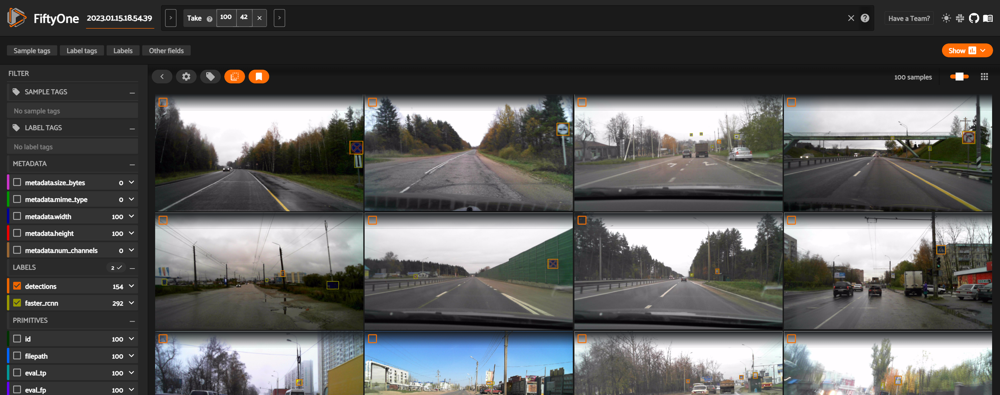

In [176]:
session.view = predictions_view


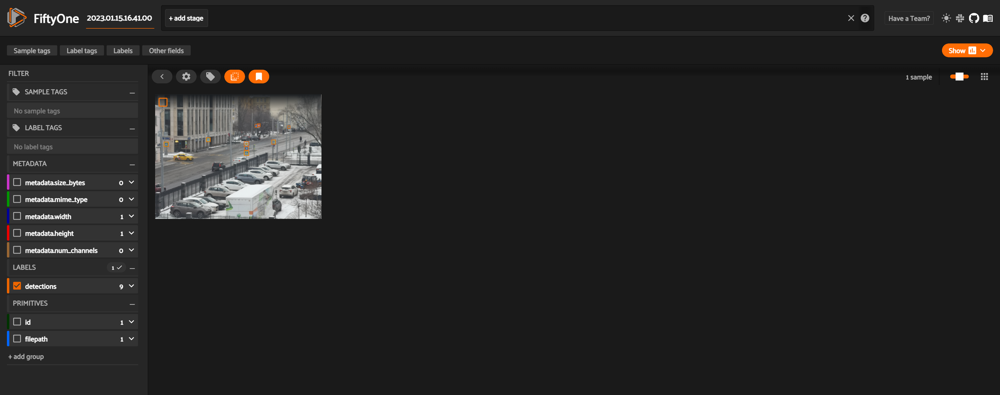

In [177]:
session.view = predictions_view.sort_by("eval_fp", reverse=True)

In [ ]:
View the worst-performing samples

In [97]:
Evaluating_detections.metrics()

{'accuracy': 0.8554216867469879,
 'precision': 0.8765432098765432,
 'recall': 0.9726027397260274,
 'fscore': 0.922077922077922,
 'support': 73}

In [110]:
#Использовать для классификатора
#Evaluating_detections.print_report()

              precision    recall  f1-score   support

        sign       0.88      0.97      0.92        73

   micro avg       0.88      0.97      0.92        73
   macro avg       0.88      0.97      0.92        73
weighted avg       0.88      0.97      0.92        73



In [115]:
Evaluating_detections.ious

array([0.8914488504178365, None, 0.8312027062991715, 0.7408497310461221,
       0.82688109814841, 0.817524560603722, 0.9075498399125262,
       0.7327781469378408, 0.8467949002459547, 0.8155511153758989,
       0.8391319357970103, 0.7301190070838857, 0.9298086033948001,
       0.9201110157868333, 0.9054347780306875, 0.796915968079401,
       0.728806740910623, 0.8884125087422116, None, None,
       0.7678336591394952, 0.8259630518722724, 0.8276616614587382,
       0.8368185766587946, 0.8414341298900498, 0.9523968676710273,
       0.8806074184097076, 0.9287081050922283, 0.777313500833757, None,
       0.8706832832565699, 0.8277106986658205, 0.8262418042338461,
       0.8616891454580932, None, None, 0.9133403663764265,
       0.8067166207090998, 0.8573657700312864, 0.8101511324316555,
       0.7337290624604396, 0.9398363616694725, 0.9137664920709668,
       0.7060668394318526, 0.9211273283036407, 0.9249784716492383,
       0.9389124484127277, 0.964488461706139, None, 0.9074749769406378,



Could not connect session, trying again in 10 seconds

Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds



Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 s

In [119]:
session.view = predictions_view.sort_by("tp_iou_0_75", reverse=True)

ValueError: Field 'tp_iou_0_75' does not exist

In [121]:

session.view = predictions_view.sort_by("fp_iou_0_75", reverse=True)

ValueError: Field 'fp_iou_0_75' does not exist

In [132]:
import os
import fiftyone as fo
import fiftyone.brain as fob
from fiftyone import ViewField as F

# Load dataset and compute mistakenness
#dataset = fo.Dataset.from_dir("/path/to/dataset", 
#    fo.types.TFObjectDetectionDataset)

fob.compute_mistakenness(val_dataset, pred_field="faster_rcnn", 
    label_field="detections")

# Find the most mistaken samples to get reannotated
mistakenness_view = val_dataset.match(F("mistakenness") > 0.75)



Evaluating detections...
Computing mistakenness...
Mistakenness computation complete


In [143]:
mistakenness_view.export("dt", fo.types.CVATImageDataset)


# Fix mistaken annotations using CVAT


# Load fixed annotations back in
#

#dataset.merge_samples(fixed_dataset, key_fcn=lambda p: os.path.basename(p))

Directory 'dt' already exists; export will be merged with existing files
Found multiple fields ['detections', 'faster_rcnn', 'faster_rcnn_75'] with compatible type <class 'fiftyone.core.labels.Detections'>; exporting 'detections'


In [144]:
fixed_dataset = fo.Dataset.from_dir("dt", fo.types.CVATImageDataset)

AttributeError: 'NoneType' object has no attribute 'get'


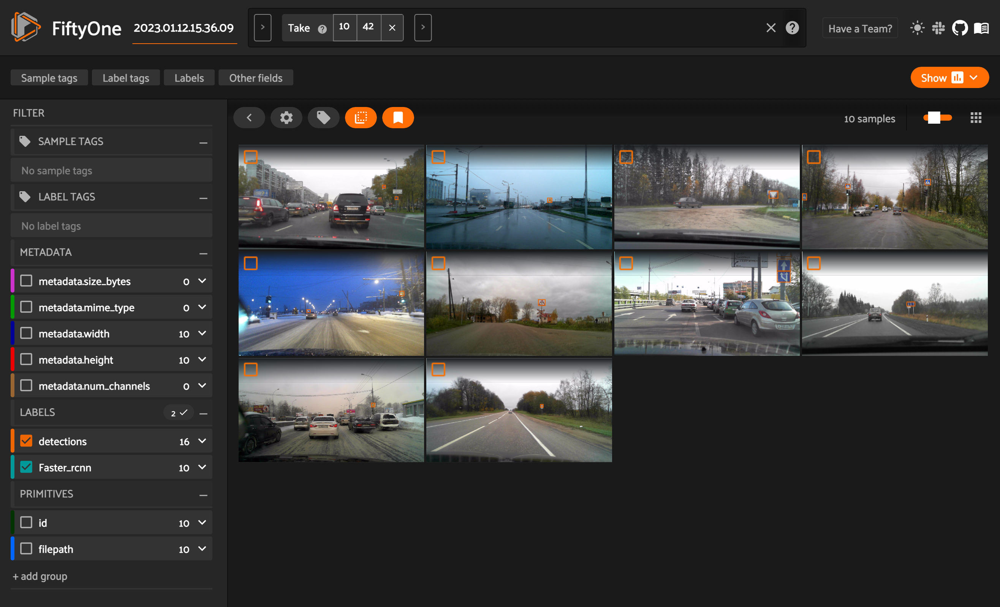


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds

Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds



Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds

Could not connect session, trying again in 10 seconds



Could not connect session, trying again in 10 seconds


Could not connect session, trying again in 10 seconds



In [192]:
session = fo.launch_app(faster_rcnn_75)


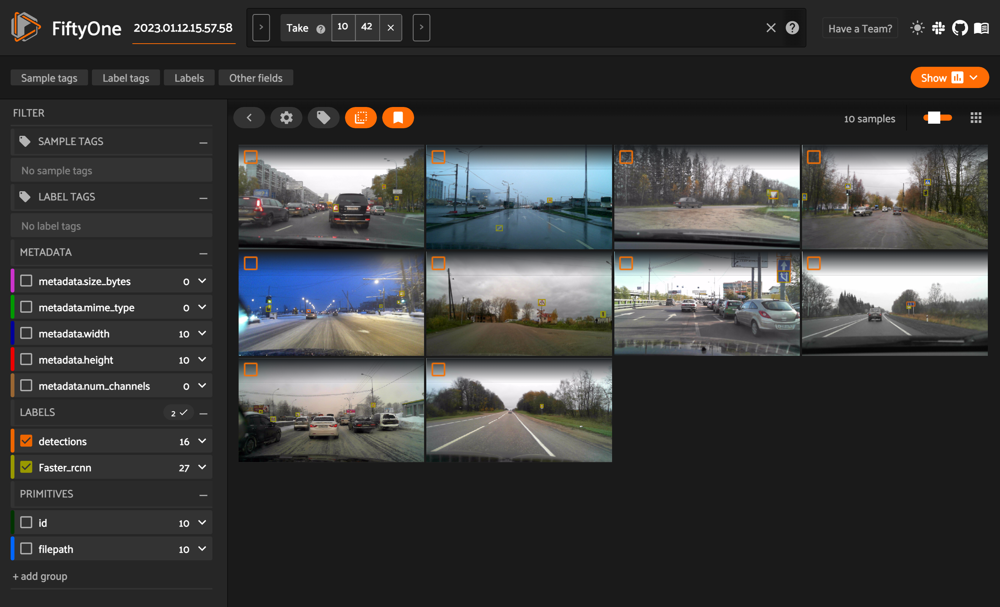

In [176]:
session = fo.launch_app(predictions_view)

In [93]:
import fiftyone.zoo as foz
test_ds = foz.load_zoo_dataset('coco-2017', split='validation')

 100% |██████|    1.9Gb/1.9Gb [4.1m elapsed, 0s remaining, 7.8Mb/s]       
Extracting annotations to '/Users/denis/fiftyone/coco-2017/raw/instances_val2017.json'
 100% |██████|    6.1Gb/6.1Gb [14.8m elapsed, 0s remaining, 7.0Mb/s]      
Extracting images to '/Users/denis/fiftyone/coco-2017/validation/data'
Writing annotations to '/Users/denis/fiftyone/coco-2017/validation/labels.json'
Dataset info written to '/Users/denis/fiftyone/coco-2017/info.json'
Loading 'coco-2017' split 'validation'
 100% |███████████████| 5000/5000 [16.0s elapsed, 0s remaining, 339.4 samples/s]      
Dataset 'coco-2017-validation' created


In [105]:
test_json = '/Users/denis/fiftyone/coco-2017/validation/labels.json'
with open(test_json, 'r') as labels_file:
    test_anno = json.load(labels_file)['categories']
test_anno[1]

{'supercategory': 'vehicle', 'id': 2, 'name': 'bicycle'}

In [4]:
import fiftyone as fo


# загрузка датасета

# The directiry containing the source images
data_path = img_path      # можно не указывать, если в JSON путь совпадает

# The path yo the COCO labels JSON file
labels_file = "val_anno_bin_class.json"
labels_path = os.path.join(data_path, labels_file)


# Import the dataset
dataset = fo.Dataset.from_dir(
    dataset_type=fo.types.COCODetectionDataset,
    data_path=data_path,
    labels_path=labels_path
)

 100% |███████████████| 5000/5000 [9.3s elapsed, 0s remaining, 614.9 samples/s]       


In [18]:
import fiftyone.zoo as foz
# Предсказание на предобученной моделе
# List available zoo models
model_names = foz.list_zoo_models()
print(model_names)


#
# Load zoo model
#
# This will download the model from the web, if necessary, and ensure
# that any required packages are installed
#
model = foz.load_zoo_model("faster-rcnn-resnet50-fpn-coco-torch")

['alexnet-imagenet-torch', 'centernet-hg104-1024-coco-tf2', 'centernet-hg104-512-coco-tf2', 'centernet-mobilenet-v2-fpn-512-coco-tf2', 'centernet-resnet101-v1-fpn-512-coco-tf2', 'centernet-resnet50-v1-fpn-512-coco-tf2', 'centernet-resnet50-v2-512-coco-tf2', 'clip-vit-base32-torch', 'deeplabv3-cityscapes-tf', 'deeplabv3-mnv2-cityscapes-tf', 'deeplabv3-resnet101-coco-torch', 'deeplabv3-resnet50-coco-torch', 'densenet121-imagenet-torch', 'densenet161-imagenet-torch', 'densenet169-imagenet-torch', 'densenet201-imagenet-torch', 'efficientdet-d0-512-coco-tf2', 'efficientdet-d0-coco-tf1', 'efficientdet-d1-640-coco-tf2', 'efficientdet-d1-coco-tf1', 'efficientdet-d2-768-coco-tf2', 'efficientdet-d2-coco-tf1', 'efficientdet-d3-896-coco-tf2', 'efficientdet-d3-coco-tf1', 'efficientdet-d4-1024-coco-tf2', 'efficientdet-d4-coco-tf1', 'efficientdet-d5-1280-coco-tf2', 'efficientdet-d5-coco-tf1', 'efficientdet-d6-1280-coco-tf2', 'efficientdet-d6-coco-tf1', 'efficientdet-d7-1536-coco-tf2', 'faster-rcnn-in

C:\Users\User\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\User\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [13]:
model.state_dict()

AttributeError: 'TorchvisionImageModel' object has no attribute 'state_dict'

In [14]:
checkpoint = torch.load('checkpoints/model_detector_resnet50_3.pth')
model.load_state_dict(checkpoint['model_state_dict'])

AttributeError: 'TorchvisionImageModel' object has no attribute 'load_state_dict'

In [9]:


#
# Load some samples from the COCO-2017 validation split
#
# This will download the dataset from the web, if necessary
#
#dataset = foz.load_zoo_dataset(
#    "coco-2017",
#    split="validation",
#    dataset_name="coco-2017-validation-sample",
#    max_samples=50,
#    shuffle=True,
#)

#
# Choose some samples to process. This can be the entire dataset, or a
# subset of the dataset. In this case, we'll choose some samples at
# random
#
samples = dataset.take(25)

#
# Generate predictions for each sample and store the results in the
# `faster_rcnn` field of the dataset, discarding all predictions with
# confidence below 0.5
#
samples.apply_model(model, label_field="faster_rcnn", confidence_thresh=0.5)
print(samples)

# Visualize predictions in the App
session = fo.launch_app(view=samples)

ValueError: Model must be a <class 'fiftyone.core.models.Model'> or flash.core.model.Task; found <class 'torchvision.models.detection.faster_rcnn.FasterRCNN'>